In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score

To Do: 

[x] team offensive/defensive rating

[x] off/def efficiency https://www.coachesclipboard.net/calculating-basketball-oer-der.html

In [10]:
# LOAD
df = pd.read_csv('historical_stats.csv')
df['GAME_DATE'] = pd.to_datetime(df['GAME_DATE'])
df = df.set_index(['GAME_DATE', 'GAME_ID', 'TEAM_ABBREVIATION'])
df = df.sort_index(level=['TEAM_ABBREVIATION', 'GAME_DATE'])

### Rolling Average Stat Calculations

In [11]:
cols = [ 'Win',
         'FGM',
         'FG_PCT',
         'FG3_PCT',
         'FT_PCT',
         'FGM_per48',
         'FGA_per48',
         'FG3M_per48',
         'FG3A_per48',
         'FTM_per48',
         'FTA_per48',
         'OREB_per48',
         'DREB_per48',
         'REB_per48',
         'AST_per48',
         'TOV_per48',
         'STL_per48',
         'BLK_per48',
         'BLKA_per48',
         'PF_per48',
         'PFD_per48',
         'PTS_per48',
         'PLUS_MINUS_per48',
         'Win_against',
         'FG_PCT_against',
         'FG3_PCT_against',
         'FGM_per48_against',
         'FGA_per48_against',
         'FG3M_per48_against',
         'FG3A_per48_against',
         'FTM_per48_against',
         'FTA_per48_against',
         'OREB_per48_against',
         'DREB_per48_against',
         'REB_per48_against',
         'AST_per48_against',
         'TOV_per48_against',
         'STL_per48_against',
         'BLK_per48_against',
         'BLKA_per48_against',
         'PF_per48_against',
         'PFD_per48_against',
         'PTS_per48_against',
       ]

In [24]:
# ewm rolling stats with 32 game window, calculated for each team to avoid spillover
df = df.sort_index(level=['GAME_DATE'], ascending=True)

span = 64
# rolling average for training data (shifted by 1 game)
df_feat = df.groupby('TEAM_ABBREVIATION', 
           group_keys=False)[cols].apply(lambda x: x.ewm(#span=span,
                                                         halflife=span/2,
                                                         min_periods=span/2,
                                                         adjust=False).mean().shift(1)).dropna()

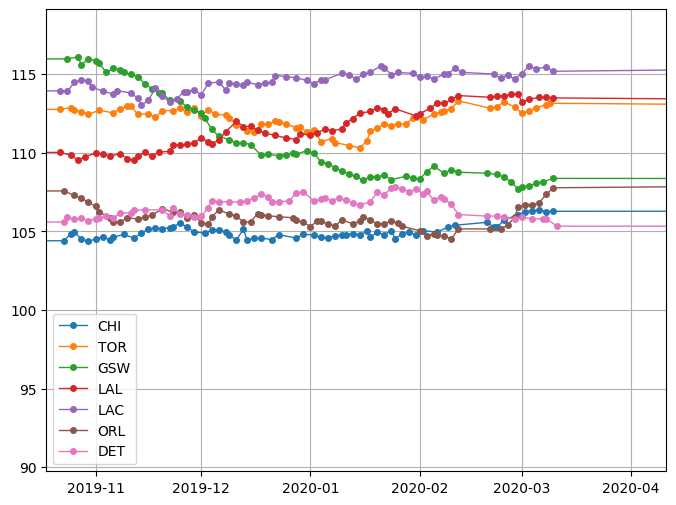

In [25]:
teams = ['CHI', 'TOR', 'GSW', 'LAL', 'LAC', 'ORL', 'DET']
plt.figure(figsize=(8, 6))
# unique_groups = df_rolling.index.get_level_values('TEAM_ABBREVIATION').unique()
unique_groups = teams
for group in unique_groups:
    group_data = df_feat[df_feat.index.get_level_values('TEAM_ABBREVIATION') == group]
    plt.plot(group_data.index.get_level_values('GAME_DATE'), group_data['PTS_per48'], 
             marker='o', linewidth=1, markersize=4, label=group)
plt.xlim(pd.Timestamp('2019-10-18'), pd.Timestamp('2020-04-11'))
plt.legend()
plt.grid(True)
plt.show()

### offensive and defensive efficiency

In [26]:
df_feat['OER'] = df_feat['PTS_per48'] / (df_feat['FGA_per48'] +
                                         ((df_feat['FTA_per48']*0.9)/2) - 
                                         df_feat['TOV_per48'])
df_feat['DER'] = df_feat['PTS_per48_against'] / (df_feat['FGA_per48_against'] +
                                                 ((df_feat['FTA_per48_against']*0.9)/2) - 
                                                 df_feat['TOV_per48_against'])

### Effective Field Goal Percentage (eFG%)

In [27]:
df_feat['eFG%'] = ((df_feat['FGM_per48'] + (0.5 * df_feat['FG3M_per48'])) / df_feat['FGA_per48']) * 100
df_feat['eFG%_against'] = ((df_feat['FGM_per48_against'] +
                            (0.5 * df_feat['FG3M_per48_against'])) / 
                           df_feat['FGA_per48_against']) * 100

### True Shooting Percentage (TS%)

In [28]:
df_feat['TS%'] = (df_feat['PTS_per48'] / (2 * (df_feat['FGA_per48'] + (0.44 * df_feat['FTA_per48'])))) * 100
df_feat['TS%_against'] = (df_feat['PTS_per48_against'] / 
                          (2 * (df_feat['FGA_per48_against'] + 
                                (0.44 * df_feat['FTA_per48_against'])))) * 100

### rest days 

In [29]:
min_date = df_feat.index.get_level_values('GAME_DATE').min()
df_feat['DaysElapsed'] = (df_feat.index.get_level_values('GAME_DATE') - min_date).days
df_feat['DaysRest'] = df_feat.groupby('TEAM_ABBREVIATION', 
           group_keys=False)['DaysElapsed'].diff()
df_feat['DaysRest'] = df_feat['DaysRest'].apply(lambda x: 5 if x>5 else x)

### 4 Amount of Home Court Advantage Explained by the Differences in Rest
Over the 2004-05 and 2005-06 seasons, the overall home court advantage was
roughly 3.24 points per game. What would happen though if both the home
teams and the road teams had the same distribution of rest? Our model lets
us answer this question. With these two distributions equal, the home court
advantage would be given by γ = 1 P30 δi (there are 30 NBA teams). Our 30 i=1
point estimate of γ from model (1) is 2.93 (points per game), with a 95% CI of (2.46 , 3.40). Thus, the different distribution of rest for the home and road teams is estimated to only account for about 0.3 points or about 10.5% of the overall home court advantage. By bootstrapping the residuals (Efron and Tibishirari, 1986), we get a 95% CI of (5.2% , 17.7%) for this percent contribution.

In [30]:
df_feat[['MATCHUP','WL']] = df[['MATCHUP','WL']]
df_feat['Home'] = df_feat['MATCHUP'].apply(lambda x: 0 if '@' in x else 1)
df_feat['WL'] = df_feat['WL'].map({'W': 1, 'L': 0})
df['WL'] = df['WL'].map({'W': 1, 'L': 0})

### Number of consecutive road games

In [31]:
def consecutive_zeros(lst):
    count = 0
    result = []
    for num in lst:
        if num == 0:
            count += 1
        else:
            count = 0
        result.append(count)
    return result

df_roadtrip = df.groupby('TEAM_ABBREVIATION', group_keys=False)['Home'].apply(lambda x: consecutive_zeros(x))

In [32]:
df_results = pd.DataFrame()
for i, group in enumerate(df_roadtrip):
    df_group = pd.DataFrame(df_roadtrip[i], 
                            index=df.loc[:,:,df_roadtrip.index[i]].index, 
                            columns=['roadtrip'])
    df_group['TEAM_ABBREVIATION'] = df_roadtrip.index[i]
    df_group = df_group.set_index('TEAM_ABBREVIATION', append=True)
    df_results = pd.concat([df_group, df_results])

In [33]:
df_feat['roadtrip'] = df_results['roadtrip']
# df_feat.dropna(inplace=True)

### Possessions, Off/Def Rating

- DDREB: defensive rebounds by opponents
- Possesions formula: (Oliver, pg 37)


In [34]:
# this seems to underestimate possesions compared to other sources...
# potentially due to opponent matching, which grabs the opponents rolling stats
# df_feat['Poss'] = (df_feat['FGA_per48'] 
#                    - (df_feat['OREB_per48'] / (df_feat['OREB_per48'] + df_feat['OREB_per48_against'])) 
#                    * (df_feat['FGA_per48'] - df_feat['FGM_per48']) * 1.07 + df_feat['TOV_per48'] 
#                    + (0.4 * df_feat['FTA_per48']))

# this one appears more in line with other sources
df_feat['Poss'] = (df_feat['FGA_per48'] - df_feat['OREB_per48'] + df_feat['TOV_per48'] + 
                   0.4 * df_feat['FTA_per48'])

In [35]:
df_feat['OffRat'] = df_feat['PTS_per48'] / df_feat['Poss'] * 100
df_feat['DefRat'] = df_feat['PTS_per48_against'] / df_feat['Poss'] * 100

### Misc Stats

In [36]:
# Rebound percentages (rebounds per shot)
# choosing not to account for rebounds on the last missed foul shot, for now
df_feat['OREB%'] = df_feat['OREB_per48'] / (df_feat['FGA_per48'] - df_feat['FGM_per48'])
df_feat['DREB%'] = df_feat['DREB_per48'] / (df_feat['FGA_per48_against'] - df_feat['FGM_per48_against'])

# TOV percentage
df_feat['TOV%'] = df_feat['TOV_per48'] / df_feat['Poss']
df_feat['TOV_forced%'] = df_feat['TOV_per48_against'] / df_feat['Poss']
df_feat['STL%'] = df_feat['TOV_per48'] / df_feat['Poss']

# Assist rate
df_feat['AST%'] = df_feat['AST_per48'] / df_feat['FGM_per48']


# WIP: BB%, ball-back %, pct chance team will get the ball back from the opponent on a possession
df_feat['BB%'] = (df_feat['TOV_per48_against'] + 
                  (df_feat['FGA_per48_against'] -
                  df_feat['FGM_per48_against'])) / df_feat['Poss']

### League-Relative standardized stats ("_z")

In [37]:
cols = ['eFG%', 'eFG%_against', 'TS%_against', 
        'OffRat', 'DefRat', 
        'OREB%', 'OREB_per48', 'DREB%', 'DREB_per48', 
        'TOV%', 'TOV_forced%', 'STL%', 'AST%', 
        'PTS_per48', 'PTS_per48_against',
        'FGM_per48','FGA_per48',
        'FG3M_per48','FG3A_per48',
        'FTM_per48','FTA_per48',
        'FGM_per48_against','FGA_per48_against',
        'FG3M_per48_against','FG3A_per48_against',
        'FTM_per48_against','FTA_per48_against']

for col in cols:
    print(col+'_z')
    df_feat[(col+'_z')] = ((df_feat[col] - 
                            (df_feat[col].transform(lambda x: x.rolling(window=960).mean()))) / 
                           df_feat[col].transform(lambda x: x.rolling(window=960).std()))


eFG%_z
eFG%_against_z
TS%_against_z
OffRat_z
DefRat_z
OREB%_z
OREB_per48_z
DREB%_z
DREB_per48_z
TOV%_z
TOV_forced%_z
STL%_z
AST%_z
PTS_per48_z
PTS_per48_against_z
FGM_per48_z
FGA_per48_z
FG3M_per48_z
FG3A_per48_z
FTM_per48_z
FTA_per48_z
FGM_per48_against_z
FGA_per48_against_z
FG3M_per48_against_z
FG3A_per48_against_z
FTM_per48_against_z
FTA_per48_against_z


In [43]:
df_feat.loc[:,:,:][['eFG%','eFG%_against','TS%','TS%_against','DaysRest', 'roadtrip', 
                        'Poss', 'OffRat', 'DefRat', 'OffRat_z', 'DefRat_z', 'OREB%', 'DREB%',
                       'TOV%', 'TOV_forced%', 'STL%', 'AST%']].dropna()

eFG%  eFG%_against        TS%  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION                                       
2013-03-13 21200960 LAL                51.620576     49.891473  53.946584   
           21200961 HOU                54.312972     50.562368  57.866507   
                    PHX                46.129714     48.466986  49.935762   
           21200962 OKC                50.468137     47.435995  55.964732   
                    UTA                48.086208     48.396278  52.975727   
...                                          ...           ...        ...   
2024-01-13 22300547 NOP                55.202900     53.951862  58.863651   
           22300548 CHI                53.717862     54.661287  57.199653   
                    SAS                52.790825     56.421743  55.946201   
           22300549 LAL                54.825156     54.508352  58.456395   
                    UTA                54.509988     54.521949  58.243010   

                                       TS%_against  DaysRest  roadtrip  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION                                    
2013-03-13 21200960 LAL                  52.921821       1.0         2   
           21200961 HOU                  54.615786       4.0         0   
                    PHX                  52.142280       2.0         1   
           21200962 OKC                  51.180829       2.0         0   
                    UTA                  52.597065       2.0         1   
...                                            ...       ...       ...   
2024-01-13 22300547 NOP                  57.489836       1.0         4   
           22300548 CHI                  57.988118       1.0         1   
                    SAS                  59.595645       1.0         0   
           22300549 LAL                  57.516812       2.0         1   
                    UTA                  57.812318       1.0         0   

                                             Poss      OffRat      DefRat  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION                                       
2013-03-13 21200960 LAL                 93.764743  106.201466  107.411115   
           21200961 HOU                 97.484687  109.659022  104.343061   
                    PHX                 95.326984   95.561451  101.101761   
           21200962 OKC                 94.132490  106.869390   99.846367   
                    UTA                 94.702608  106.715615  102.053328   
...                                           ...         ...         ...   
2024-01-13 22300547 NOP                 99.717250  115.355290  111.323744   
           22300548 CHI                 97.823034  112.457680  112.789993   
                    SAS                103.877201  108.469779  116.398668   
           22300549 LAL                102.063907  112.270920  112.840902   
                    UTA                102.062312  113.497783  114.200410   

                                       OffRat_z  DefRat_z     OREB%     DREB%  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION                                           
2013-03-13 21200960 LAL                0.736158  1.447372  0.284831  0.693507   
           21200961 HOU                1.403426  0.713434  0.257001  0.712554   
                    PHX               -1.324102 -0.064030  0.243740  0.674685   
           21200962 OKC                0.863152 -0.363573  0.250111  0.711833   
                    UTA                0.832023  0.164307  0.309343  0.711992   
...                                         ...       ...       ...       ...   
2024-01-13 22300547 NOP                0.700702 -0.815580  0.238326  0.715749   
           22300548 CHI               -0.311864 -0.205355  0.217189  0.712268   
                    SAS               -1.702133  1.293925  0.210995  0.711229   
           22300549 LAL               -0.374648 -0.186496  0.201750  0.716645   
                    UTA                0.053661  0.379293  0.253679  0.712921   

                       

### Opponent matching + previous 5 games

In [39]:
num_games = len(df_feat.index.get_level_values('GAME_ID').unique())
num_games

13320

In [49]:
cols = ['Win', 'DaysRest', 'FG_PCT', 'FG3_PCT', 'FT_PCT', 'FGM_per48', 'FGA_per48', 'FG3M_per48', 'FG3A_per48', 'FTM_per48',
        'FTA_per48', 'OREB_per48', 'DREB_per48', 'REB_per48', 'AST_per48', 'TOV_per48', 'STL_per48', 'BLK_per48',
        'BLKA_per48', 'PF_per48', 'PFD_per48', 'PTS_per48', 'PLUS_MINUS_per48', 'FG_PCT_against',
        'FG3_PCT_against', 'FGM_per48_against', 'FGA_per48_against', 'FG3M_per48_against',
        'FG3A_per48_against', 'FTM_per48_against', 'FTA_per48_against', 'OREB_per48_against', 'DREB_per48_against',
        'REB_per48_against', 'AST_per48_against', 'TOV_per48_against', 'STL_per48_against', 'BLK_per48_against',
        'BLKA_per48_against', 'PF_per48_against', 'PFD_per48_against', 'PTS_per48_against',
        'eFG%','TS%','eFG%_against', 'TS%_against','DaysRest', 'roadtrip', 'Poss', 'OffRat', 'DefRat', 'OREB%', 'DREB%',
        'TOV%', 'TOV_forced%', 'STL%', 'AST%',
        'eFG%_z','eFG%_against_z','TS%_against_z','OffRat_z','DefRat_z',
        'OREB%_z','OREB_per48_z','DREB%_z','DREB_per48_z','TOV%_z','TOV_forced%_z','STL%_z','AST%_z',
        'PTS_per48_z','PTS_per48_against_z','FGM_per48_z','FGA_per48_z','FG3M_per48_z','FG3A_per48_z',
        'FTM_per48_z','FTA_per48_z','FGM_per48_against_z','FGA_per48_against_z',
        'FG3M_per48_against_z','FG3A_per48_against_z','FTM_per48_against_z','FTA_per48_against_z']

prev_matchup_cols = ['OREB_per48','OREB%_z','DREB_per48','DREB%_z','REB_per48', 
                     'FGA_per48', 'FG3A_per48', 'FTA_per48', 
                     'WL', 'OffRat', 'DefRat', 'OffRat_z', 'DefRat_z',
                     'PTS_per48_z','PTS_per48_against_z',
                     'FGM_per48_z','FGA_per48_z','FG3M_per48_z','FG3A_per48_z',
                     'FTM_per48_z','FTA_per48_z','FGM_per48_against_z','FGA_per48_against_z',
                     'FG3M_per48_against_z','FG3A_per48_against_z','FTM_per48_against_z','FTA_per48_against']

num_games = len(df_feat.index.get_level_values('GAME_ID').unique())

for i, game_id in enumerate(df_feat.index.get_level_values('GAME_ID').unique()):
      # Print 'ok' every 5% of the loop
    if i % (num_games // 20) == 0:
        print(np.round(i/num_games*100))
    
    
    team_abvs = df_feat.loc[:,game_id,:].index.get_level_values('TEAM_ABBREVIATION')
    if len(team_abvs) < 2:
        print('no opponent match')
    else:
        for col in cols:
#         for col in df_feat.columns:
            col_name = col + '_opp'

            df_feat.loc[(slice(None), game_id, team_abvs[0]), 
                            col_name] = df_feat.loc[(slice(None), 
                                                     game_id, team_abvs[1])][col].iloc[0]
               
            df_feat.loc[(slice(None), game_id, team_abvs[1]), 
                            col_name] = df_feat.loc[(slice(None), 
                                                     game_id, team_abvs[0])][col].iloc[0]
            
            # calc rolling avg stats for previous 6 games against opponent ("_prev")
            if col in prev_matchup_cols:
                team1_index = df.loc[:,:,team_abvs[0]].index.get_level_values(1).unique()
                team2_index = df.loc[:,:,team_abvs[1]].index.get_level_values(1).unique()
                df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
#                 df_matchup = df_feat.loc[:, df_feat.index.get_level_values('TEAM_ABBREVIATION').isin(team1_index.intersection(team2_index)), :]
        
                df_team1 = df_matchup.loc[:,:, team_abvs[0]][col].rolling(6).mean().shift(1)
                df_team2 = df_matchup.loc[:,:, team_abvs[1]][col].rolling(6).mean().shift(1)
                col_name = col + '_prev'

                df_feat.loc[(slice(None), game_id, team_abvs[0]), 
                                    col_name] = df_team1.loc[(slice(None), game_id)].iloc[0]
                df_feat.loc[(slice(None), game_id, team_abvs[1]), 
                                    col_name] = df_team2.loc[(slice(None), game_id)].iloc[0]

0.0
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match
no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

5.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match
no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match
no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match
no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match
no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


no opponent match
no opponent match


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

10.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

15.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


20.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

25.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

30.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


35.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

40.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


45.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


50.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

55.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

60.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


65.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

70.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

75.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

80.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


85.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

90.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

95.0


/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]
/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn

/var/folders/2w/6p2pcvgn3sg1l6mtkw0q1xtr0000gn/T/ipykernel_23640/723731611.py:52: FutureWarning: The behavior of indexing on a MultiIndex with a nested sequence of labels is deprecated and will change in a future version. `series.loc[label, sequence]` will raise if any members of 'sequence' or not present in the index's second level. To retain the old behavior, use `series.index.isin(sequence, level=1)`
  df_matchup = df_feat.loc[:,team1_index.intersection(team2_index),:]


In [50]:
df_feat = df_feat.dropna()
df_feat

Win        FGM    FG_PCT  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION                                  
2014-10-29 21400004 CHA                0.552285  36.488970  0.444516   
                    MIL                0.232768  36.970078  0.448307   
           21400008 ATL                0.451469  37.203130  0.459670   
                    TOR                0.582294  36.555960  0.449012   
           21400009 MEM                0.643055  38.020922  0.464942   
...                                         ...        ...       ...   
2024-01-13 22300547 NOP                0.556780  42.450249  0.486353   
           22300548 CHI                0.489832  41.736871  0.474870   
                    SAS                0.241057  42.581795  0.462427   
           22300549 LAL                0.502776  42.420159  0.485549   
                    UTA                0.504286  42.532733  0.473082   

                                        FG3_PCT    FT_PCT  FGM_per48  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION                                  
2014-10-29 21400004 CHA                0.350288  0.751727  36.021379   
                    MIL                0.361357  0.744127  36.713654   
           21400008 ATL                0.352394  0.780613  36.978336   
                    TOR                0.370809  0.785540  36.093331   
           21400009 MEM                0.348969  0.733736  37.814884   
...                                         ...       ...        ...   
2024-01-13 22300547 NOP                0.376687  0.783405  42.267164   
           22300548 CHI                0.357721  0.798011  41.183485   
                    SAS                0.347912  0.767345  42.287872   
           22300549 LAL                0.355242  0.766726  42.157410   
                    UTA                0.351461  0.805427  42.179043   

                                       FGA_per48  FG3M_per48  FG3A_per48  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION                                      
2014-10-29 21400004 CHA                81.259963    6.527290   18.608539   
                    MIL                82.190624    6.500136   18.194930   
           21400008 ATL                80.608537    9.066878   25.566284   
                    TOR                80.645887    8.578857   22.881644   
           21400009 MEM                81.491539    4.778865   13.721833   
...                                          ...         ...         ...   
2024-01-13 22300547 NOP                87.096500   11.625259   30.653591   
           22300548 CHI                87.006034   11.108592   30.881848   
                    SAS                91.554764   12.089287   34.781670   
           22300549 LAL                86.983677   11.063051   30.996067   
                    UTA                89.349548   13.050770   37.010714   

                                       FTM_per48  ...  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION             ...   
2014-10-29 21400004 CHA                17.788832  ...   
                    MIL                17.012640  ...   
           21400008 ATL                16.636913  ...   
                    TOR                19.265863  ...   
           21400009 MEM                15.227099  ...   
...                                          ...  ...   
2024-01-13 22300547 NOP                18.869535  ...   
           22300548 CHI                16.533953  ...   
                    SAS                16.010341  ...   
           22300549 LAL                19.210215  ...   
                    UTA                18.429606  ...   

                                       FGM_per48_against_z_prev  \
GAME_DATE  GAME_ID  TEAM_ABBREVIATION                             
2014-10-29 21400004 CHA                                0.289074   
                    MIL                                0.736104   
           21400008 ATL                                1.003082   
                    TOR                               -0.705149   
           21400009 MEM              

In [52]:
for col in df_feat.columns:
    print(col)

Win
FGM
FG_PCT
FG3_PCT
FT_PCT
FGM_per48
FGA_per48
FG3M_per48
FG3A_per48
FTM_per48
FTA_per48
OREB_per48
DREB_per48
REB_per48
AST_per48
TOV_per48
STL_per48
BLK_per48
BLKA_per48
PF_per48
PFD_per48
PTS_per48
PLUS_MINUS_per48
Win_against
FG_PCT_against
FG3_PCT_against
FGM_per48_against
FGA_per48_against
FG3M_per48_against
FG3A_per48_against
FTM_per48_against
FTA_per48_against
OREB_per48_against
DREB_per48_against
REB_per48_against
AST_per48_against
TOV_per48_against
STL_per48_against
BLK_per48_against
BLKA_per48_against
PF_per48_against
PFD_per48_against
PTS_per48_against
OER
DER
eFG%
eFG%_against
TS%
TS%_against
DaysElapsed
DaysRest
MATCHUP
WL
Home
roadtrip
Poss
OffRat
DefRat
OREB%
DREB%
TOV%
TOV_forced%
STL%
AST%
BB%
eFG%_z
eFG%_against_z
TS%_against_z
OffRat_z
DefRat_z
OREB%_z
OREB_per48_z
DREB%_z
DREB_per48_z
TOV%_z
TOV_forced%_z
STL%_z
AST%_z
PTS_per48_z
PTS_per48_against_z
FGM_per48_z
FGA_per48_z
FG3M_per48_z
FG3A_per48_z
FTM_per48_z
FTA_per48_z
FGM_per48_against_z
FGA_per48_against_z

In [51]:
df_feat.to_csv('features.csv')